In [1]:
import pandas as pd
import os
import PIL.Image
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D          
import matplotlib.patches as patches

from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation, Flatten,Lambda,Layer
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,TimeDistributed,RepeatVector,Merge
from keras.preprocessing.text import one_hot
from keras.preprocessing import sequence
import numpy as np
from keras.layers.normalization import BatchNormalization

from keras.models import Sequential,Model
from keras.layers.core import Dense, Dropout, Activation, Flatten, MaxoutDense
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,TimeDistributed,RepeatVector,Merge,Input,merge,UpSampling2D

from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
from numpy.random import random, permutation, randn, normal 
import PIL.Image
import os
import json
from tqdm import tqdm
from keras.layers.core import Activation, Reshape, Permute


from keras.optimizers import SGD, RMSprop, Adam

import cPickle as pickle
from matplotlib import pyplot as plt

from itertools import compress

import shutil
import string

import collections
import nltk
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import stopwords

import bcolz
import cPickle as pickle

from random import shuffle

import cv2

from keras import backend as K
smooth = 1.


Using Theano backend.
Using gpu device 0: GeForce GTX 1080 (CNMeM is disabled, cuDNN 5110)
/opt/conda/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [2]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)


def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

def get_unet(img_rows, img_cols):
    
    inputs = Input((3, img_rows, img_cols))
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(inputs)
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(pool1)
    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(pool2)
    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(pool3)
    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(pool4)
    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(conv5)

    up6 = merge([UpSampling2D(size=(2, 2))(conv5), conv4], mode='concat', concat_axis=1)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(up6)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv6)

    up7 = merge([UpSampling2D(size=(2, 2))(conv6), conv3], mode='concat', concat_axis=1)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(up7)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv7)

    up8 = merge([UpSampling2D(size=(2, 2))(conv7), conv2], mode='concat', concat_axis=1)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(up8)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv8)

    up9 = merge([UpSampling2D(size=(2, 2))(conv8), conv1], mode='concat', concat_axis=1)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(up9)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv9)

    conv10 = Convolution2D(1, 1, 1, activation='sigmoid')(conv9)

    model = Model(input=inputs, output=conv10)

    model.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy')
#     model.compile(optimizer=Adam(lr=1e-5),loss=dice_coef_loss, metrics=[dice_coef])
    return model

def get_segnet():

    img_w = 224
    img_h = 224
    n_labels = 1

    kernel = 3
    pad = 1
    pool_size = 2

    encoding_layers = [
        Convolution2D(64, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(64, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        MaxPooling2D(pool_size=(pool_size, pool_size)),

        Convolution2D(128, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(128, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        MaxPooling2D(pool_size=(pool_size, pool_size)),

        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        MaxPooling2D(pool_size=(pool_size, pool_size)),

        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        MaxPooling2D(pool_size=(pool_size, pool_size)),

        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        MaxPooling2D(pool_size=(pool_size, pool_size)),
    ]

    decoding_layers = [
        UpSampling2D(size=(pool_size,pool_size)),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),

        UpSampling2D(size=(pool_size,pool_size)),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(512, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),

        UpSampling2D(size=(pool_size,pool_size)),
        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(256, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(128, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),

        UpSampling2D(size=(pool_size,pool_size)),
        Convolution2D(128, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(64, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),

        UpSampling2D(size=(pool_size,pool_size)),
        Convolution2D(64, kernel, kernel, border_mode='same'),
        BatchNormalization(),
        Activation('relu'),
        Convolution2D(n_labels, 1, 1, border_mode='valid'),
        BatchNormalization(),
    ]


    segnet_basic = Sequential()

    segnet_basic.add(Layer(input_shape=(3, 224, 224)))


    segnet_basic.encoding_layers = encoding_layers
    for l in segnet_basic.encoding_layers:
        segnet_basic.add(l)


    segnet_basic.decoding_layers = decoding_layers
    for l in segnet_basic.decoding_layers:
        segnet_basic.add(l)


#     segnet_basic.add(Reshape((n_labels, img_h * img_w), input_shape=(1,img_h, img_w)))
#     segnet_basic.add(Permute((2, 1)))
    segnet_basic.add(Activation('sigmoid'))
        
    segnet_basic.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy')
        
    return segnet_basic

# Images

In [3]:
pictures_base_folder = "./RoadMarkingDataset/"
pictures_paths = [path for path in os.listdir(pictures_base_folder) if ".jpg" in path]
pictures_paths.sort()

In [4]:
pictures_paths[:10]

['roadmark_0001.jpg',
 'roadmark_0002.jpg',
 'roadmark_0003.jpg',
 'roadmark_0004.jpg',
 'roadmark_0005.jpg',
 'roadmark_0006.jpg',
 'roadmark_0007.jpg',
 'roadmark_0008.jpg',
 'roadmark_0009.jpg',
 'roadmark_0010.jpg']

In [5]:
len(pictures_paths)

1443

In [6]:
def fix_size(img):
    if len(img.shape) == 3:
            return img
    
    new_img = np.expand_dims(img,axis=2)
    new_img = np.concatenate([new_img,new_img,new_img],axis=2)
    return new_img
    

In [7]:
images = [PIL.Image.open(pictures_base_folder+image_file_name) for image_file_name in tqdm(pictures_paths)]
images = np.stack([fix_size(np.asarray(img)) for img in images])


100%|██████████| 1443/1443 [00:00<00:00, 9230.41it/s]


In [8]:
images.shape

(1443, 600, 800, 3)

/opt/conda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


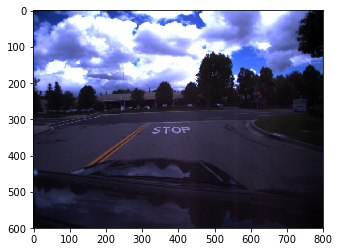

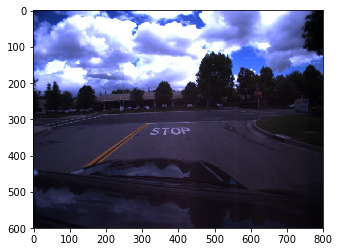

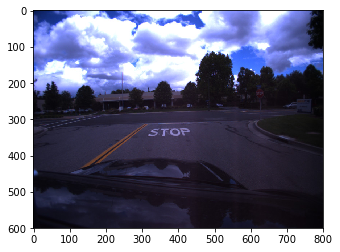

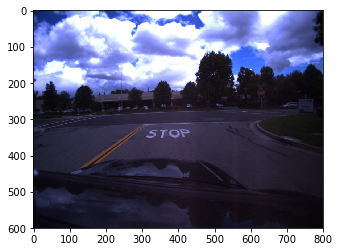

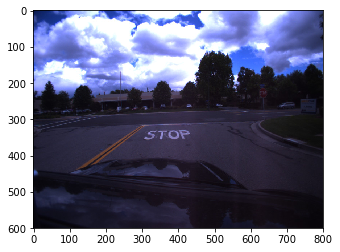

...

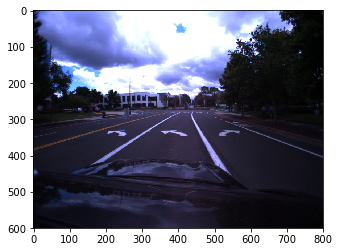

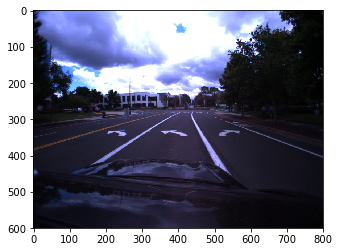

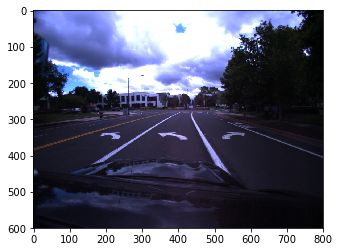

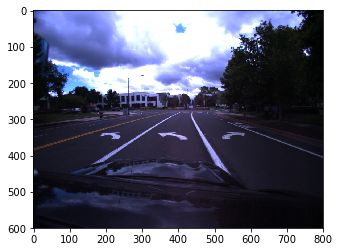

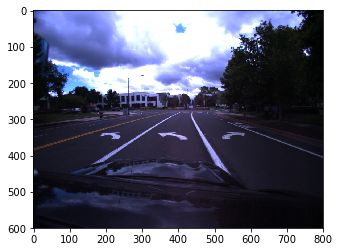

In [9]:
for img in images[:30]:
    plt.imshow(img)
    plt.figure()
plt.show()

# Labels

In [10]:
annotation_path = "./RoadMarkingDataset/dataset_annotations.txt"
dataDf = pd.read_csv(annotation_path,index_col='picture')

In [11]:
dataDf

,x1,y1,x2,y2,x3,y3,x4,y4,type
picture,,,,,,,,,
roadmark_0001.png,321.964233,456.406830,433.777863,335.275360,344.327148,344.327148,317.166656,317.166656,stop
roadmark_0002.png,313.977539,453.744598,433.777863,329.950928,350.500000,349.265442,317.166656,317.166656,stop
roadmark_0003.png,307.321960,449.751251,429.784515,325.957581,352.969147,351.734558,317.166656,320.870361,stop
roadmark_0004.png,299.335266,452.413483,431.115631,323.295349,359.141968,359.141968,320.870361,322.104950,stop
roadmark_0005.png,295.341919,461.731293,431.115631,316.639771,362.845673,361.611115,322.104950,325.808655,stop
roadmark_0006.png,287.355255,455.075714,428.453400,311.315308,367.783966,366.549377,324.574066,330.746918,stop
roadmark_0007.png,284.693024,455.075714,429.784515,309.984192,373.956787,370.253082,327.043213,329.512360,stop
roadmark_0008.png,267.388519,460.400177,425.791168,304.659729,378.895050,378.895050,330.746918,331.981476,stop
roadmark_0009.png,262.064056,455.075714,428.453400,295.341919,383.833344,382.598755,334.450623,335.685181,stop


In [12]:
dataDf.groupby(['type']).size()

type
25                15
30                 2
35               112
40                69
X-crossing         6
bike              41
car                1
clear              6
diamond            1
forward           80
forward&left       6
forward&right     13
hump               3
keep               6
lane               1
leftturn         705
ped               54
pool               1
rail              90
rightturn        101
school             3
slow               2
speed              2
stop              49
stripe             3
xing              64
yield              7
dtype: int64

In [13]:
masks = []

for index,row in tqdm(enumerate(dataDf.values)):
    x1 = int(row[0])
    y1 = int(row[1])
    
    x2 = int(row[2])
    y2 = int(row[3])
    
    x3 = int(row[4])
    y3 = int(row[5])
    
    x4 = int(row[6])
    y4 = int(row[7])
    
    img = images[index]
    
    mask = np.zeros((img.shape[0],img.shape[1]))

    mask[y4:y3,x1:x2] = 1
            
    masks.append(mask)
    
masks = np.stack(masks)

    

1443it [00:00, 1834.80it/s]


In [14]:
masks.shape

(1443, 600, 800)

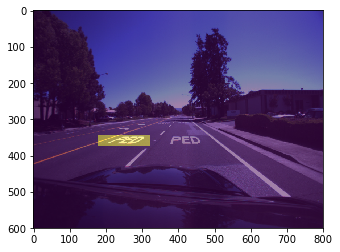

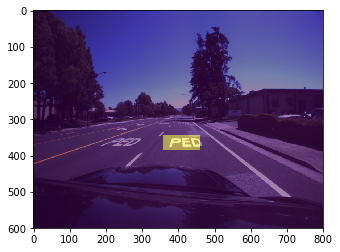

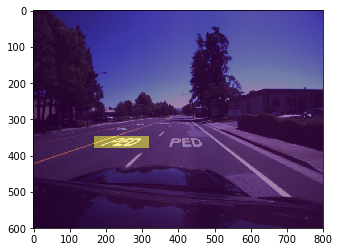

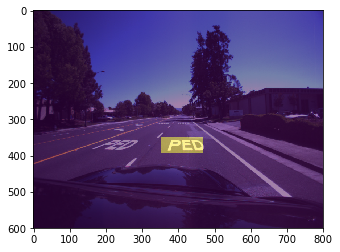

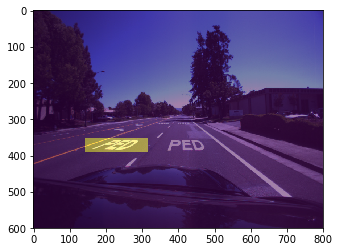

...

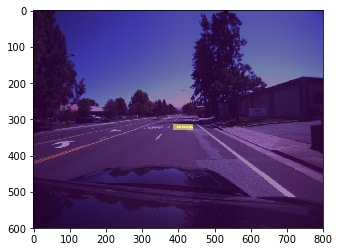

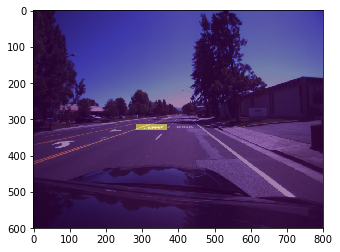

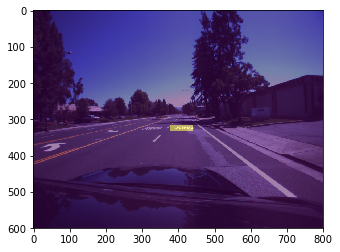

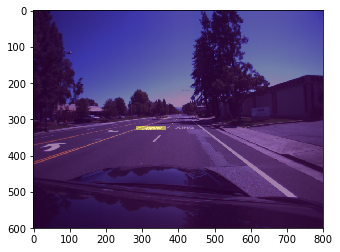

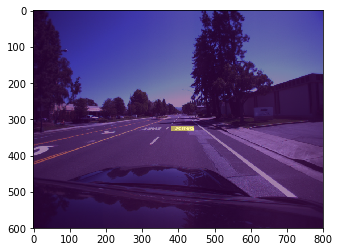

In [15]:
for index in range(500,525):
    img = images[index]
    mask = masks[index]
    
    plt.imshow(img)
    plt.imshow(mask, alpha=0.5)

    plt.figure()
    
plt.show()

In [16]:
print(images.shape)
print(masks.shape)

(1443, 600, 800, 3)
(1443, 600, 800)


In [50]:
images_format = [np.asarray(PIL.Image.fromarray(img[250:,:,...]).resize((448, 448), PIL.Image.NEAREST)) for img in tqdm(images)]
masks_format = [np.asarray(PIL.Image.fromarray(mask[250:,:,...]).resize((448, 448), PIL.Image.NEAREST)) for mask in tqdm(masks)]

images_format = np.stack(images_format)
masks_format = np.stack(masks_format)

images_format = np.transpose(images_format,(0,3,1,2))
masks_format = np.transpose(np.expand_dims(masks_format,axis=3),(0,3,1,2)) 

100%|██████████| 1443/1443 [00:04<00:00, 320.03it/s]


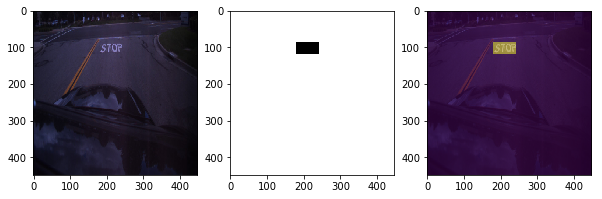

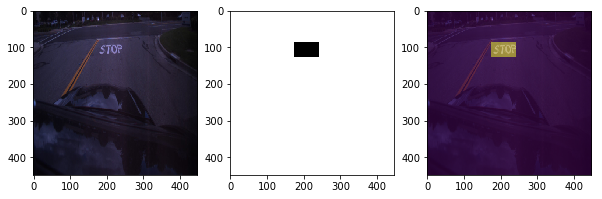

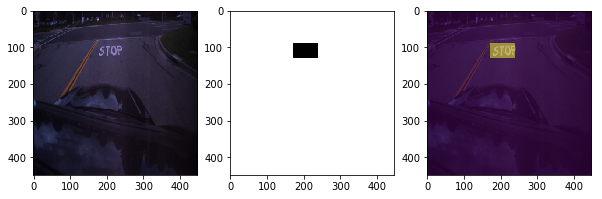

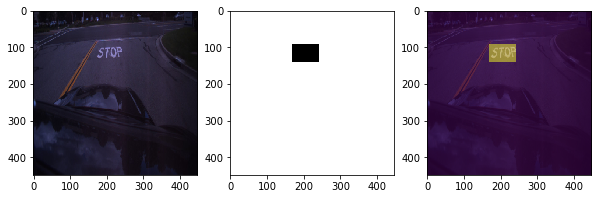

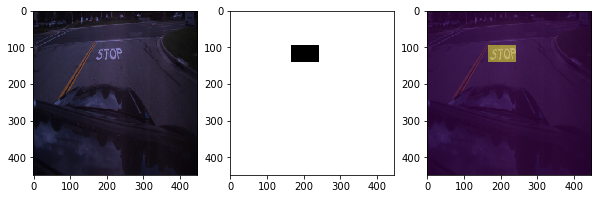

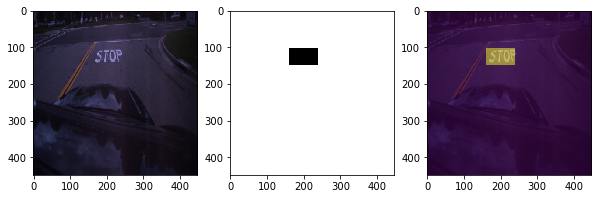

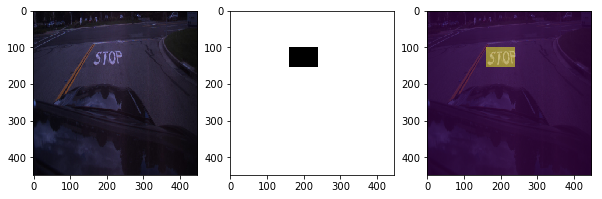

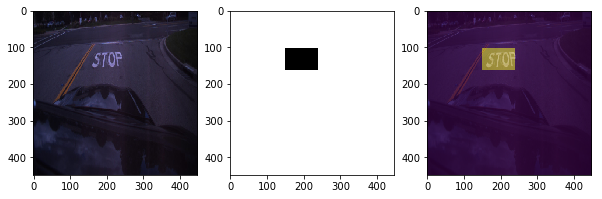

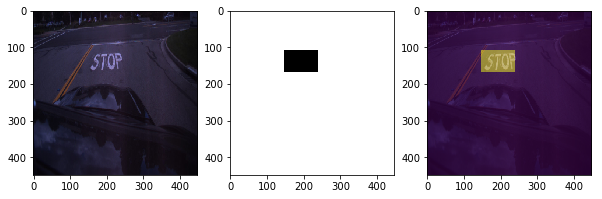

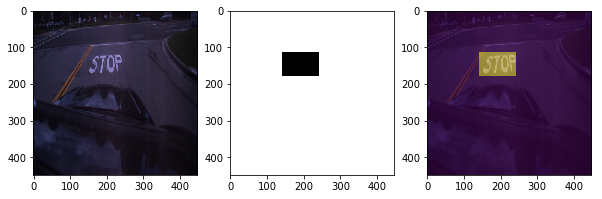

In [51]:
fig_size= 10

for i in range(10):

    plt.figure(figsize=(fig_size,fig_size))
    
    current_data = np.transpose(images_format[i],(1,2,0))
    current_pred = np.squeeze(masks_format[i])
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_pred, cmap='Greys')
    
    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_pred, alpha=0.5)

    plt.figure(figsize=(fig_size,fig_size))

plt.show()

## Net

In [52]:
print(images_format.shape)
print(masks_format.shape)

(1443, 3, 448, 448)
(1443, 1, 448, 448)


In [53]:
x_mean = np.mean(images_format)
x_std = np.std(images_format)

images_format_normalized =  (images_format-x_mean) / x_std

In [54]:
masks_format.shape

(1443, 1, 448, 448)

In [55]:
model = get_unet(448,448)

In [ ]:
model.fit(images_format_normalized, 
          masks_format,
          batch_size=8, 
          nb_epoch=5
         )

Epoch 1/5
1443/1443 [==============================] - 282s - loss: 12.5179     

# Predict

In [60]:
preds_format = images_format_normalized[500:700]
original_images_for_preds = images_format[500:700]

In [ ]:
preds = model.predict(preds_format)
preds.shape

(200, 1, 448, 448)

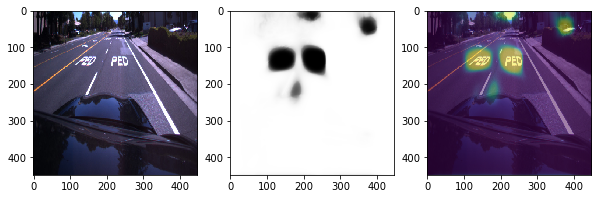

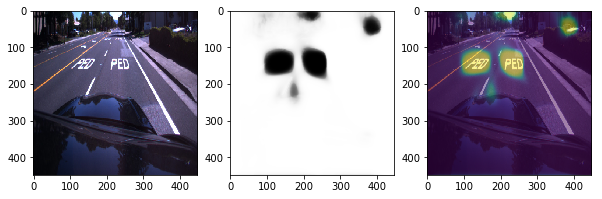

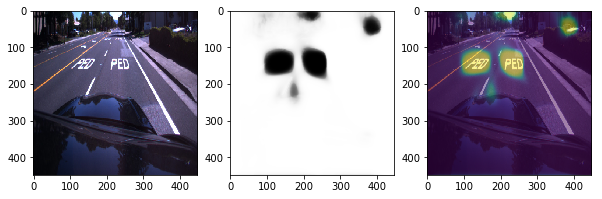

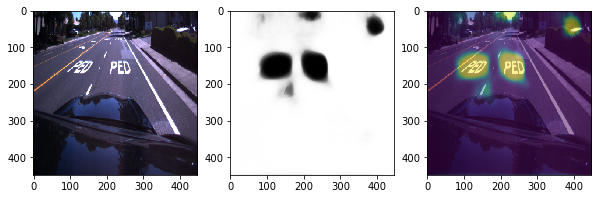

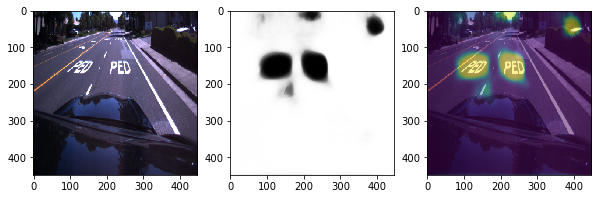

...

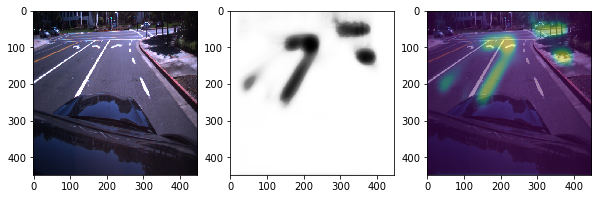

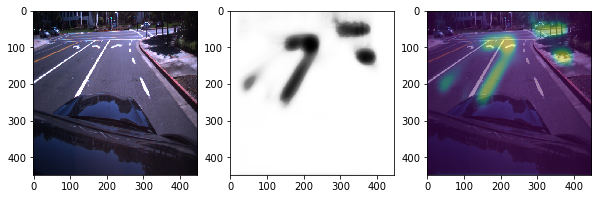

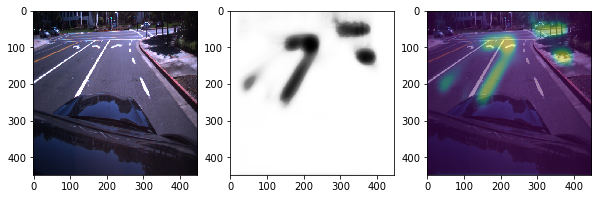

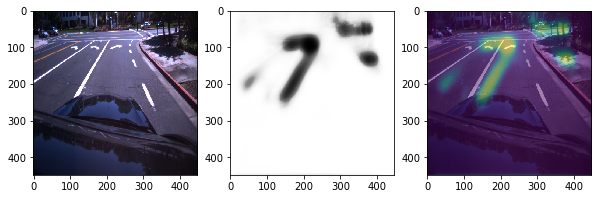

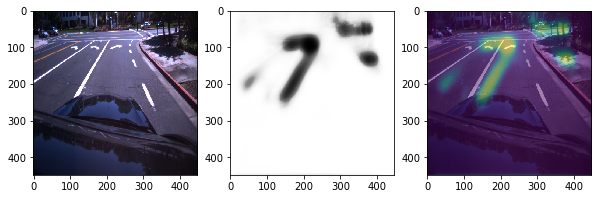

In [ ]:
fig_size= 10

for i in range(200):

    plt.figure(figsize=(fig_size,fig_size))
    
    current_data = np.transpose(original_images_for_preds[i],(1,2,0))
    current_pred = np.squeeze(preds[i])
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_pred, cmap='Greys')
    
    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_pred, alpha=0.5)

    plt.figure(figsize=(fig_size,fig_size))

plt.show()

In [ ]:
model.save_weights("./unet-224.h5")

In [38]:
image.shape

(600, 800, 3)